In [35]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/crowd-counting/crowd_wala_dataset/test_data/ground_truth/GT_IMG_309.mat
/kaggle/input/crowd-counting/crowd_wala_dataset/test_data/ground_truth/GT_IMG_89.mat
/kaggle/input/crowd-counting/crowd_wala_dataset/test_data/ground_truth/GT_IMG_98.mat
/kaggle/input/crowd-counting/crowd_wala_dataset/test_data/ground_truth/GT_IMG_236.mat
/kaggle/input/crowd-counting/crowd_wala_dataset/test_data/ground_truth/GT_IMG_172.mat
/kaggle/input/crowd-counting/crowd_wala_dataset/test_data/ground_truth/GT_IMG_142.mat
/kaggle/input/crowd-counting/crowd_wala_dataset/test_data/ground_truth/GT_IMG_53.mat
/kaggle/input/crowd-counting/crowd_wala_dataset/test_data/ground_truth/GT_IMG_273.mat
/kaggle/input/crowd-counting/crowd_wala_dataset/test_data/ground_truth/GT_IMG_271.mat
/kaggle/input/crowd-counting/crowd_wala_dataset/test_data/ground_truth/GT_IMG_94.mat
/kaggle/input/crowd-counting/crowd_wala_dataset/test_data/ground_truth/GT_IMG_25.mat
/kaggle/input/crowd-counting/crowd_wala_dataset/test_data/g

In [36]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import torchvision.models as models # For pre-trained backbone
from torchvision.ops import nms # For NMS
from torch.cuda.amp import GradScaler, autocast # For Mixed Precision Training
from sklearn.cluster import DBSCAN

from PIL import Image
import scipy.io as sio
import numpy as np
import matplotlib.pyplot as plt
from tqdm.autonotebook import tqdm # tqdm.autonotebook for better display in notebooks
import math
import os
import cv2 # For image resizing and augmentation
import random # For setting seeds

# Albumentations for advanced augmentation
import albumentations as A
from albumentations.pytorch import ToTensorV2

from sklearn.model_selection import train_test_split # For splitting data

In [37]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")
# Seed for reproducibility
def set_seed(seed):
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    np.random.seed(seed)
    random.seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False # Set to False for reproducibility

SET_RANDOM_SEED = 42 # You can change this
set_seed(SET_RANDOM_SEED)
print(f"Random seed set to {SET_RANDOM_SEED}")

Using device: cuda
Random seed set to 42


In [38]:
DATASET_BASE_PATH = '/kaggle/input/crowd-counting' # Adjust if running locally
ORIGINAL_TRAIN_DATA_PATH = os.path.join(DATASET_BASE_PATH, 'crowd_wala_dataset', 'train_data')
ORIGINAL_TRAIN_IMAGES_PATH = os.path.join(ORIGINAL_TRAIN_DATA_PATH, 'images')
ORIGINAL_TRAIN_GT_PATH = os.path.join(ORIGINAL_TRAIN_DATA_PATH, 'ground_truth')

ORIGINAL_TEST_DATA_PATH = os.path.join(DATASET_BASE_PATH, 'crowd_wala_dataset', 'test_data')
ORIGINAL_TEST_IMAGES_PATH = os.path.join(ORIGINAL_TEST_DATA_PATH, 'images')
ORIGINAL_TEST_GT_PATH = os.path.join(ORIGINAL_TEST_DATA_PATH, 'ground_truth')

In [39]:
IMG_HEIGHT = 256
IMG_WIDTH = 256
BATCH_SIZE = 8 # Increased for better GPU utilization and potentially faster training
EPOCHS = 20 # Increased epochs, will use early stopping later
STRIDE = 8 # Feature map resolution 1/8 of original image size
MATCH_DIST_THRESHOLD = 10 # Pixels in original image scale
CONFIDENCE_THRESHOLD = 0.5
NMS_IOU_THRESHOLD = 0.5
OFFSET_LOSS_WEIGHT = 10.0 # Weight for offset loss, can be tuned


In [40]:
def load_image_and_gt_paths(image_dir, gt_dir):
    image_filenames = sorted([f for f in os.listdir(image_dir) if f.endswith(('.jpg', '.png', '.jpeg'))])
    gt_filenames = sorted([f for f in os.listdir(gt_dir) if f.endswith('.mat')])

    image_paths = []
    gt_paths = []

    for img_fname in image_filenames:
        base_name = os.path.splitext(img_fname)[0]
        gt_fname_cand1 = base_name + '.mat'
        gt_fname_cand2 = 'GT_' + base_name + '.mat' 
        gt_path_cand1 = os.path.join(gt_dir, gt_fname_cand1)
        gt_path_cand2 = os.path.join(gt_dir, gt_fname_cand2)

        if os.path.exists(gt_path_cand1):
            image_paths.append(os.path.join(image_dir, img_fname))
            gt_paths.append(gt_path_cand1)
        elif os.path.exists(gt_path_cand2):
            image_paths.append(os.path.join(image_dir, img_fname))
            gt_paths.append(gt_path_cand2)
        else:
            print(f"Warning: No matching GT found for image {img_fname} in {gt_dir}")

    print(f"Found {len(image_paths)} image-GT pairs in {image_dir}")
    return image_paths, gt_paths

In [41]:
def load_points_from_mat(mat_path):
    try:
        gt_data = sio.loadmat(mat_path)
        points = np.array([])

        if 'image_info' in gt_data and gt_data['image_info'].shape[0] > 0:
            info_struct = gt_data['image_info'][0,0]
            if 'location' in info_struct.dtype.names:
                if info_struct['location'].shape == (1, 1) and isinstance(info_struct['location'][0,0], np.ndarray):
                    points = info_struct['location'][0,0]
                else:
                    points = info_struct['location']
            elif 'annPoints' in info_struct.dtype.names:
                points = info_struct['annPoints']
        elif 'annPoints' in gt_data:
            points = gt_data['annPoints']
        elif 'points' in gt_data:
            points = gt_data['points']
        elif 'gt' in gt_data:
            points = gt_data['gt']
        if points.size > 0:
            if points.ndim == 3 and points.shape[0] == 1:
                points = points.reshape(-1, 2)
            elif points.ndim == 2 and points.shape[1] != 2:
                if points.size % 2 == 0:
                    points = points.reshape(-1, 2)
                else:
                    points = np.array([]) 
            elif points.ndim == 1 and points.size % 2 == 0:
                points = points.reshape(-1, 2)
            elif points.ndim != 2 or points.shape[1] != 2: 
                 points = np.array([]) 

        return points
    except Exception as e:
        print(f"Error loading points from {mat_path}: {e}")
        return np.array([])

In [42]:
def generate_point_gt_maps(gt_points_scaled, img_height, img_width, stride, match_dist_threshold):
    feature_map_height = img_height // stride
    feature_map_width = img_width // stride

    y_conf = np.zeros((feature_map_height, feature_map_width, 1), dtype=np.float32)
    y_offset = np.zeros((feature_map_height, feature_map_width, 2), dtype=np.float32)

    if gt_points_scaled.size == 0: 
        return y_conf, y_offset
    grid_x = np.arange(0, feature_map_width) * stride + (stride / 2)
    grid_y = np.arange(0, feature_map_height) * stride + (stride / 2)
    grid_centers_x, grid_centers_y = np.meshgrid(grid_x, grid_y)
    grid_centers = np.stack([grid_centers_x, grid_centers_y], axis=-1) # (H_fm, W_fm, 2)
    grid_centers_flat = grid_centers.reshape(-1, 2) # (H_fm * W_fm, 2)
    distances = np.sqrt(np.sum((gt_points_scaled[:, np.newaxis, :] - grid_centers_flat[np.newaxis, :, :])**2, axis=-1))t
    min_dist_to_gt_per_cell = np.min(distances, axis=0)
    closest_gt_idx_per_cell = np.argmin(distances, axis=0)
    positive_cells_flat_idx = np.where(min_dist_to_gt_per_cell <= match_dist_threshold)[0]
    
    if positive_cells_flat_idx.size > 0:
        positive_cells_fy = positive_cells_flat_idx // feature_map_width
        positive_cells_fx = positive_cells_flat_idx % feature_map_width
        y_conf[positive_cells_fy, positive_cells_fx, 0] = 1.0
        corresponding_gt_indices = closest_gt_idx_per_cell[positive_cells_flat_idx]
        gt_heads_for_pos_cells = gt_points_scaled[corresponding_gt_indices]
        pos_cell_centers_x = (positive_cells_fx * stride) + (stride / 2)
        pos_cell_centers_y = (positive_cells_fy * stride) + (stride / 2)
        offsets_x = (gt_heads_for_pos_cells[:, 0] - pos_cell_centers_x) / stride
        offsets_y = (gt_heads_for_pos_cells[:, 1] - pos_cell_centers_y) / stride
        y_offset[positive_cells_fy, positive_cells_fx, 0] = offsets_x
        y_offset[positive_cells_fy, positive_cells_fx, 1] = offsets_y
    
    return y_conf, y_offset

In [43]:
class CrowdPointPyTorchDataset(Dataset):
    def __init__(self, image_paths, gt_paths, img_height, img_width, stride, match_dist_threshold, augment_pipeline=None):
        self.image_paths = image_paths
        self.gt_paths = gt_paths
        self.img_height = img_height
        self.img_width = img_width
        self.stride = stride
        self.match_dist_threshold = match_dist_threshold
        self.augment_pipeline = augment_pipeline

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        gt_path = self.gt_paths[idx]
        image = np.array(Image.open(img_path).convert("RGB"))
        original_h, original_w, _ = image.shape 

        gt_points = load_points_from_mat(gt_path)
        keypoints = []
        if gt_points.size > 0:
            keypoints = gt_points.tolist() 
        if self.augment_pipeline:
            transformed = self.augment_pipeline(image=image, keypoints=keypoints)
            image_augmented = transformed['image']
            gt_points_augmented = np.array(transformed['keypoints'])
        else:
            image_augmented = cv2.resize(image, (self.img_width, self.img_height), interpolation=cv2.INTER_AREA)
            if gt_points.size > 0:
                gt_points_augmented = gt_points.copy()
                gt_points_augmented[:, 0] = gt_points_augmented[:, 0] * (self.img_width / original_w)
                gt_points_augmented[:, 1] = gt_points_augmented[:, 1] * (self.img_height / original_h)
            else:
                gt_points_augmented = np.array([])
        image_tensor = image_augmented 
        y_conf_np, y_offset_np = generate_point_gt_maps(
            gt_points_augmented, self.img_height, self.img_width, self.stride, self.match_dist_threshold
        )
        y_conf_tensor = torch.from_numpy(y_conf_np).permute(2, 0, 1) # H, W, C -> C, H, W
        y_offset_tensor = torch.from_numpy(y_offset_np).permute(2, 0, 1) # H, W, C -> C, H, W

        return image_tensor, (y_conf_tensor, y_offset_tensor)

In [44]:
train_transforms = A.Compose([
    A.Resize(IMG_HEIGHT, IMG_WIDTH, interpolation=cv2.INTER_AREA),
    A.HorizontalFlip(p=0.5),
    A.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1, p=0.7),
    A.GaussNoise(p=0.2),
    A.Perspective(scale=(0.05, 0.1), p=0.2), # Adds slight perspective distortions
    A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.05, rotate_limit=15, p=0.5, border_mode=cv2.BORDER_CONSTANT, value=0),
    A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)), # ImageNet stats
    ToTensorV2(),
], keypoint_params=A.KeypointParams(format='xy', remove_invisible=False))

val_test_transforms = A.Compose([
    A.Resize(IMG_HEIGHT, IMG_WIDTH, interpolation=cv2.INTER_AREA),
    A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)), # ImageNet stats
    ToTensorV2(),
], keypoint_params=A.KeypointParams(format='xy', remove_invisible=False))


# --- FULL APGCC-style MODEL (adapted to point-based output) ---
class MultiScaleBlock(nn.Module):
    def __init__(self, in_channels):
        super().__init__()
        self.conv1 = nn.Conv2d(in_channels, in_channels, 3, padding=1)
        self.bn1 = nn.BatchNorm2d(in_channels)
        self.conv2 = nn.Conv2d(in_channels, in_channels, 5, padding=2)
        self.bn2 = nn.BatchNorm2d(in_channels)
        self.conv3 = nn.Conv2d(in_channels, in_channels, 7, padding=3)
        self.bn3 = nn.BatchNorm2d(in_channels)
        self.fuse = nn.Conv2d(in_channels * 3, in_channels, 1)
        self.bn_fuse = nn.BatchNorm2d(in_channels)
        self.relu = nn.ReLU(inplace=True)

    def forward(self, x):
        x1 = self.relu(self.bn1(self.conv1(x)))
        x2 = self.relu(self.bn2(self.conv2(x)))
        x3 = self.relu(self.bn3(self.conv3(x)))
        return self.relu(self.bn_fuse(self.fuse(torch.cat([x1, x2, x3], dim=1))))

class AttentionBlock(nn.Module):
    def __init__(self, in_channels):
        super().__init__()
        # Simplified Channel Attention
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        self.fc = nn.Sequential(
            nn.Conv2d(in_channels, in_channels // 8, 1, bias=False),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels // 8, in_channels, 1, bias=False),
            nn.Sigmoid()
        )

    def forward(self, x):
        w = self.avg_pool(x)
        w = self.fc(w)
        return x * w

/usr/local/lib/python3.11/dist-packages/albumentations/core/validation.py:87: UserWarning: ShiftScaleRotate is a special case of Affine transform. Please use Affine transform instead.
  original_init(self, **validated_kwargs)
/tmp/ipykernel_35/1998419105.py:8: UserWarning: Argument(s) 'value' are not valid for transform ShiftScaleRotate
  A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.05, rotate_limit=15, p=0.5, border_mode=cv2.BORDER_CONSTANT, value=0),


In [45]:
class APGCCPointNet(nn.Module):
    def __init__(self):
        super().__init__()
        vgg16_features = models.vgg16(pretrained=True).features
        self.encoder = nn.Sequential(*list(vgg16_features)[:23]) 
        self.encoder = nn.Sequential(*list(vgg16_features)[:17]) 

        ENCODER_OUT_CHANNELS = 256 
        self.multiscale_attn_block = nn.Sequential(
            MultiScaleBlock(ENCODER_OUT_CHANNELS),
            AttentionBlock(ENCODER_OUT_CHANNELS)
        )

        self.confidence_head = nn.Conv2d(ENCODER_OUT_CHANNELS, 1, 1, bias=True)
        self.offset_head = nn.Conv2d(ENCODER_OUT_CHANNELS, 2, 1, bias=True)

    def forward(self, x):
        feature_map = self.encoder(x)
        processed_feature_map = self.multiscale_attn_block(feature_map)

        confidence_output = self.confidence_head(processed_feature_map) 
        offset_output = self.offset_head(processed_feature_map) 

        return confidence_output, offset_output

In [46]:
def apgcc_point_loss(y_true_conf, y_true_offset, y_pred_conf_logits, y_pred_offset, delta=1.0, offset_loss_weight=10.0):
    bce_loss_fn = nn.BCEWithLogitsLoss(reduction='none')
    conf_loss_per_pixel = bce_loss_fn(y_pred_conf_logits, y_true_conf)
    conf_loss = torch.mean(conf_loss_per_pixel)
    positive_mask = y_true_conf.float()
    positive_mask_broadcastable = positive_mask.repeat(1, 2, 1, 1) 
    error = y_true_offset - y_pred_offset
    abs_error = torch.abs(error)
    squared_loss = 0.5 * torch.square(error)
    squared_mask = (abs_error <= delta).float()
    linear_loss = delta * (abs_error - 0.5 * delta)
    linear_mask = (abs_error > delta).float()
    offset_loss_raw = squared_loss * squared_mask + linear_loss * linear_mask
    weighted_offset_error = offset_loss_raw * positive_mask_broadcastable
    num_positive_elements = torch.sum(positive_mask) * 2
    offset_loss = torch.sum(weighted_offset_error) / (num_positive_elements + 1e-6)

    # Combine total loss
    total_loss = conf_loss + offset_loss_weight * offset_loss
    return total_loss

In [47]:
if __name__ == "__main__":
    for path in [ORIGINAL_TRAIN_IMAGES_PATH, ORIGINAL_TRAIN_GT_PATH, 
                  ORIGINAL_TEST_IMAGES_PATH, ORIGINAL_TEST_GT_PATH]:
        if not os.path.exists(path):
            print(f"Error: Original dataset path not found: {path}. Please ensure your dataset is correctly structured.")
            exit()
    print("Original dataset paths verified for PyTorch implementation.")
    all_train_image_paths, all_train_gt_paths = load_image_and_gt_paths(ORIGINAL_TRAIN_IMAGES_PATH, ORIGINAL_TRAIN_GT_PATH)
    all_test_image_paths, all_test_gt_paths = load_image_and_gt_paths(ORIGINAL_TEST_IMAGES_PATH, ORIGINAL_TEST_GT_PATH)
    train_img_paths, val_img_paths, train_gt_paths, val_gt_paths = train_test_split(
        all_train_image_paths, all_train_gt_paths, test_size=0.2, random_state=SET_RANDOM_SEED
    )
    train_dataset = CrowdPointPyTorchDataset(
        train_img_paths, train_gt_paths, IMG_HEIGHT, IMG_WIDTH, STRIDE, MATCH_DIST_THRESHOLD, augment_pipeline=train_transforms
    )
    val_dataset = CrowdPointPyTorchDataset(
        val_img_paths, val_gt_paths, IMG_HEIGHT, IMG_WIDTH, STRIDE, MATCH_DIST_THRESHOLD, augment_pipeline=val_test_transforms
    )
    test_dataset = CrowdPointPyTorchDataset(
        all_test_image_paths, all_test_gt_paths, IMG_HEIGHT, IMG_WIDTH, STRIDE, MATCH_DIST_THRESHOLD, augment_pipeline=val_test_transforms
    )

    train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=os.cpu_count() // 2 or 2, pin_memory=True if device.type == 'cuda' else False)
    val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=os.cpu_count() // 2 or 2, pin_memory=True if device.type == 'cuda' else False)
    test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False, num_workers=os.cpu_count() // 2 or 2, pin_memory=True if device.type == 'cuda' else False) # Batch size 1 for visualization

    print(f"\n--- PyTorch Data Loader Setup ---")
    print(f"Number of training batches: {len(train_loader)}")
    print(f"Number of validation batches: {len(val_loader)}")
    print(f"Number of test batches: {len(test_loader)}")


Original dataset paths verified for PyTorch implementation.
Found 400 image-GT pairs in /kaggle/input/crowd-counting/crowd_wala_dataset/train_data/images
Found 316 image-GT pairs in /kaggle/input/crowd-counting/crowd_wala_dataset/test_data/images

--- PyTorch Data Loader Setup ---
Number of training batches: 40
Number of validation batches: 10
Number of test batches: 316


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)



Starting PyTorch model training...


/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/tmp/ipykernel_35/3862980158.py:7: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler() if device.type == 'cuda' else None


Epoch 1/20 Train:   0%|          | 0/40 [00:00<?, ?it/s]

/tmp/ipykernel_35/3862980158.py:27: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast(enabled=device.type == 'cuda'): # Enable AMP if CUDA


Epoch 1/20 Val:   0%|          | 0/10 [00:00<?, ?it/s]

/tmp/ipykernel_35/3862980158.py:54: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast(enabled=device.type == 'cuda'):


Epoch 1/20 - Train Loss: 1.7686, Val Loss: 1.3707, LR: 0.000100
Model saved: best_apgcc_model.pth


Epoch 2/20 Train:   0%|          | 0/40 [00:00<?, ?it/s]

Epoch 2/20 Val:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch 2/20 - Train Loss: 1.3552, Val Loss: 1.1536, LR: 0.000100
Model saved: best_apgcc_model.pth


Epoch 3/20 Train:   0%|          | 0/40 [00:00<?, ?it/s]

Epoch 3/20 Val:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch 3/20 - Train Loss: 1.2180, Val Loss: 1.0469, LR: 0.000100
Model saved: best_apgcc_model.pth


Epoch 4/20 Train:   0%|          | 0/40 [00:00<?, ?it/s]

Epoch 4/20 Val:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch 4/20 - Train Loss: 1.1246, Val Loss: 0.9588, LR: 0.000100
Model saved: best_apgcc_model.pth


Epoch 5/20 Train:   0%|          | 0/40 [00:00<?, ?it/s]

Epoch 5/20 Val:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch 5/20 - Train Loss: 1.0649, Val Loss: 0.9020, LR: 0.000100
Model saved: best_apgcc_model.pth


Epoch 6/20 Train:   0%|          | 0/40 [00:00<?, ?it/s]

Epoch 6/20 Val:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch 6/20 - Train Loss: 1.0131, Val Loss: 0.8693, LR: 0.000100
Model saved: best_apgcc_model.pth


Epoch 7/20 Train:   0%|          | 0/40 [00:00<?, ?it/s]

Epoch 7/20 Val:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch 7/20 - Train Loss: 0.9824, Val Loss: 0.8437, LR: 0.000100
Model saved: best_apgcc_model.pth


Epoch 8/20 Train:   0%|          | 0/40 [00:00<?, ?it/s]

Epoch 8/20 Val:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch 8/20 - Train Loss: 0.9416, Val Loss: 0.8115, LR: 0.000100
Model saved: best_apgcc_model.pth


Epoch 9/20 Train:   0%|          | 0/40 [00:00<?, ?it/s]

Epoch 9/20 Val:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch 9/20 - Train Loss: 0.9103, Val Loss: 0.7858, LR: 0.000100
Model saved: best_apgcc_model.pth


Epoch 10/20 Train:   0%|          | 0/40 [00:00<?, ?it/s]

Epoch 10/20 Val:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch 10/20 - Train Loss: 0.9054, Val Loss: 0.7824, LR: 0.000100
Model saved: best_apgcc_model.pth


Epoch 11/20 Train:   0%|          | 0/40 [00:00<?, ?it/s]

Epoch 11/20 Val:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch 11/20 - Train Loss: 0.8892, Val Loss: 0.7572, LR: 0.000100
Model saved: best_apgcc_model.pth


Epoch 12/20 Train:   0%|          | 0/40 [00:00<?, ?it/s]

Epoch 12/20 Val:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch 12/20 - Train Loss: 0.8630, Val Loss: 0.7413, LR: 0.000100
Model saved: best_apgcc_model.pth


Epoch 13/20 Train:   0%|          | 0/40 [00:00<?, ?it/s]

Epoch 13/20 Val:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch 13/20 - Train Loss: 0.8411, Val Loss: 0.7345, LR: 0.000100
Model saved: best_apgcc_model.pth


Epoch 14/20 Train:   0%|          | 0/40 [00:00<?, ?it/s]

Epoch 14/20 Val:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch 14/20 - Train Loss: 0.8297, Val Loss: 0.7399, LR: 0.000100


Epoch 15/20 Train:   0%|          | 0/40 [00:00<?, ?it/s]

Epoch 15/20 Val:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch 15/20 - Train Loss: 0.8349, Val Loss: 0.7175, LR: 0.000100
Model saved: best_apgcc_model.pth


Epoch 16/20 Train:   0%|          | 0/40 [00:00<?, ?it/s]

Epoch 16/20 Val:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch 16/20 - Train Loss: 0.8087, Val Loss: 0.7117, LR: 0.000100
Model saved: best_apgcc_model.pth


Epoch 17/20 Train:   0%|          | 0/40 [00:00<?, ?it/s]

Epoch 17/20 Val:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch 17/20 - Train Loss: 0.8073, Val Loss: 0.7266, LR: 0.000100


Epoch 18/20 Train:   0%|          | 0/40 [00:00<?, ?it/s]

Epoch 18/20 Val:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch 18/20 - Train Loss: 0.8011, Val Loss: 0.6947, LR: 0.000100
Model saved: best_apgcc_model.pth


Epoch 19/20 Train:   0%|          | 0/40 [00:00<?, ?it/s]

Epoch 19/20 Val:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch 19/20 - Train Loss: 0.7871, Val Loss: 0.6926, LR: 0.000100
Model saved: best_apgcc_model.pth


Epoch 20/20 Train:   0%|          | 0/40 [00:00<?, ?it/s]

Epoch 20/20 Val:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch 20/20 - Train Loss: 0.7862, Val Loss: 0.6948, LR: 0.000100

PyTorch model training complete.
Loaded best model for evaluation.


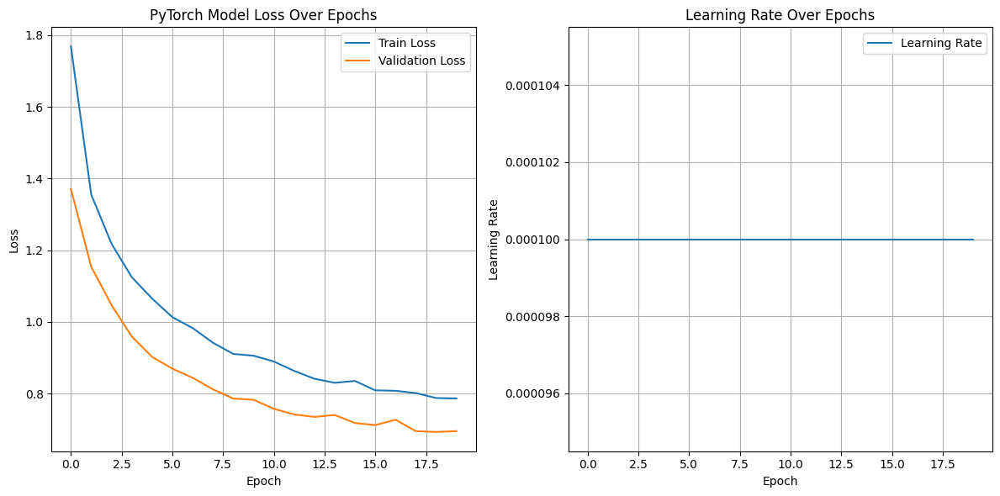

In [48]:
model_pytorch = APGCCPointNet().to(device)
optimizer = torch.optim.Adam(model_pytorch.parameters(), lr=0.0001)
# Learning Rate Scheduler
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=10, verbose=True)

# Mixed Precision Scaler
scaler = GradScaler() if device.type == 'cuda' else None

print("\nStarting PyTorch model training...")
history_pytorch = {'train_loss': [], 'val_loss': [], 'lr': []}

best_val_loss = float('inf')
patience_counter = 0
EARLY_STOPPING_PATIENCE = 10 # Number of epochs to wait for improvement

for epoch in range(EPOCHS):
    model_pytorch.train()
    running_loss = 0.0
    # Use tqdm for progress bar
    pbar = tqdm(train_loader, desc=f"Epoch {epoch+1}/{EPOCHS} Train")
    for i, (images, targets) in enumerate(pbar):
        y_true_conf, y_true_offset = targets
        images, y_true_conf, y_true_offset = images.to(device), y_true_conf.to(device), y_true_offset.to(device)

        optimizer.zero_grad()
        
        with autocast(enabled=device.type == 'cuda'): # Enable AMP if CUDA
            y_pred_conf_logits, y_pred_offset = model_pytorch(images)
            loss = apgcc_point_loss(y_true_conf, y_true_offset, y_pred_conf_logits, y_pred_offset, offset_loss_weight=OFFSET_LOSS_WEIGHT)
        
        if scaler: # Use scaler for AMP
            scaler.scale(loss).backward()
            scaler.step(optimizer)
            scaler.update()
        else: # Standard backprop
            loss.backward()
            optimizer.step()
        
        running_loss += loss.item()
        pbar.set_postfix(loss=f"{loss.item():.4f}")

    avg_train_loss = running_loss / len(train_loader)
    history_pytorch['train_loss'].append(avg_train_loss)

    # Validation
    model_pytorch.eval()
    val_loss = 0.0
    pbar_val = tqdm(val_loader, desc=f"Epoch {epoch+1}/{EPOCHS} Val")
    with torch.no_grad():
        for images, targets in pbar_val:
            y_true_conf, y_true_offset = targets
            images, y_true_conf, y_true_offset = images.to(device), y_true_conf.to(device), y_true_offset.to(device)
            
            with autocast(enabled=device.type == 'cuda'):
                y_pred_conf_logits, y_pred_offset = model_pytorch(images)
                loss = apgcc_point_loss(y_true_conf, y_true_offset, y_pred_conf_logits, y_pred_offset, offset_loss_weight=OFFSET_LOSS_WEIGHT)
            
            val_loss += loss.item()
            pbar_val.set_postfix(loss=f"{loss.item():.4f}")
    avg_val_loss = val_loss / len(val_loader)
    history_pytorch['val_loss'].append(avg_val_loss)
    history_pytorch['lr'].append(optimizer.param_groups[0]['lr'])

    print(f"Epoch {epoch+1}/{EPOCHS} - Train Loss: {avg_train_loss:.4f}, Val Loss: {avg_val_loss:.4f}, LR: {optimizer.param_groups[0]['lr']:.6f}")

    scheduler.step(avg_val_loss) 
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        patience_counter = 0
        torch.save(model_pytorch.state_dict(), 'best_apgcc_model.pth')
        print("Model saved: best_apgcc_model.pth")
    else:
        patience_counter += 1
        if patience_counter >= EARLY_STOPPING_PATIENCE:
            print(f"Early stopping triggered after {patience_counter} epochs without improvement.")
            break

print("\nPyTorch model training complete.")

# Load best model for evaluation
if os.path.exists('best_apgcc_model.pth'):
    model_pytorch.load_state_dict(torch.load('best_apgcc_model.pth'))
    print("Loaded best model for evaluation.")
else:
    print("No best model saved. Evaluating with the last trained model.")


# Plot training history
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.plot(history_pytorch['train_loss'], label='Train Loss')
plt.plot(history_pytorch['val_loss'], label='Validation Loss')
plt.title('PyTorch Model Loss Over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)

plt.subplot(1, 2, 2)
plt.plot(history_pytorch['lr'], label='Learning Rate')
plt.title('Learning Rate Over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Learning Rate')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()


--- Performing Inference and Evaluation on PyTorch TEST Images ---


Processing PyTorch test images:   0%|          | 0/316 [00:00<?, ?it/s]

/tmp/ipykernel_35/1294194085.py:21: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast(enabled=device.type == 'cuda'):
/tmp/ipykernel_35/1294194085.py:107: UserWarning: You passed a edgecolor/edgecolors ('black') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  plt.scatter(filtered_points_np[:, 0], filtered_points_np[:, 1],


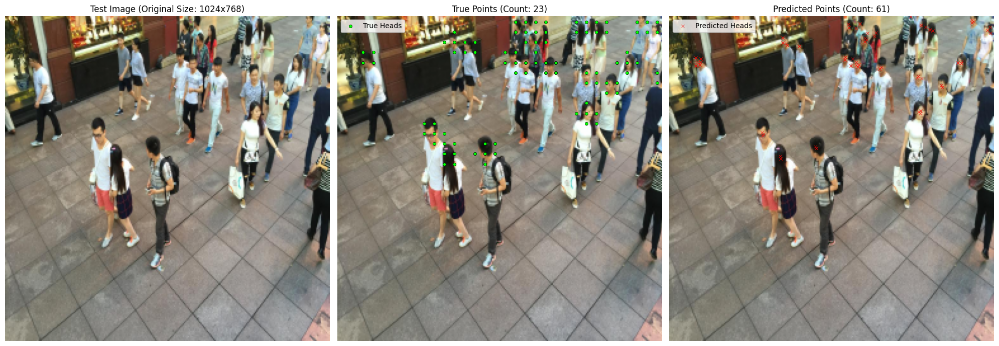

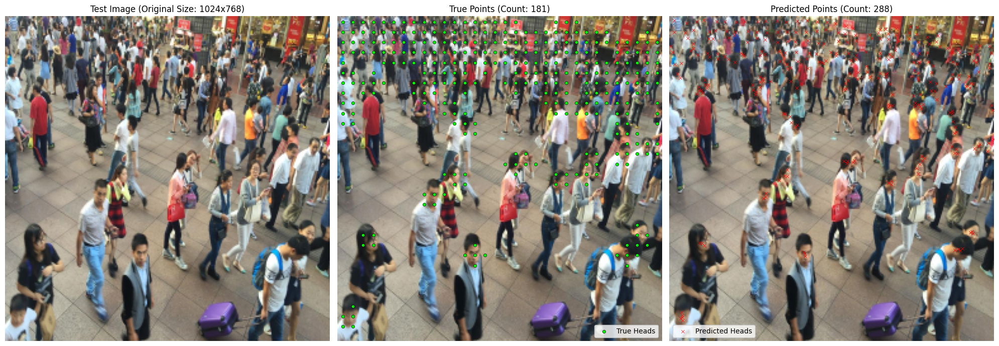

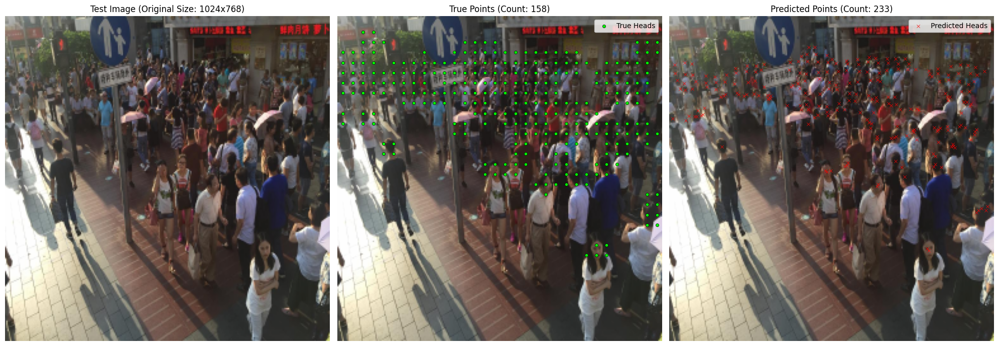

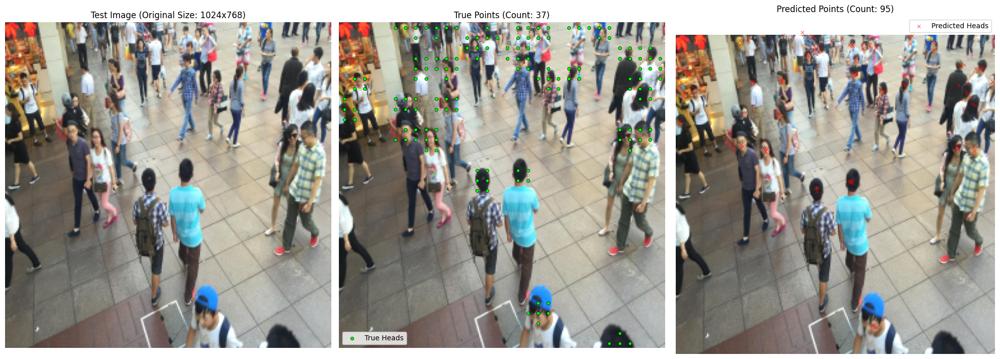

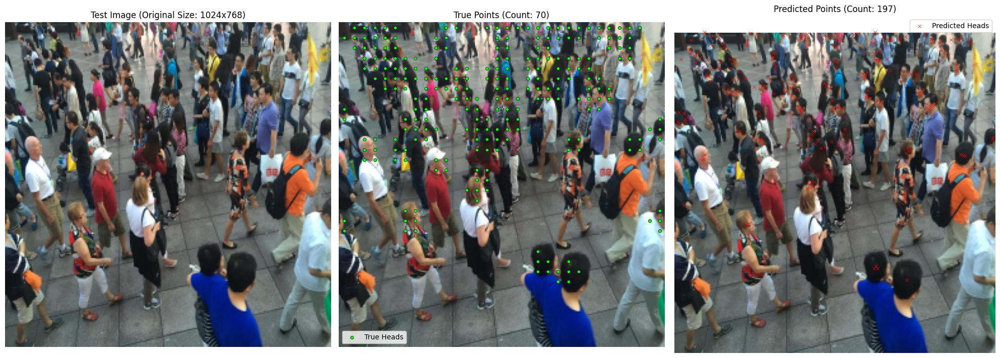

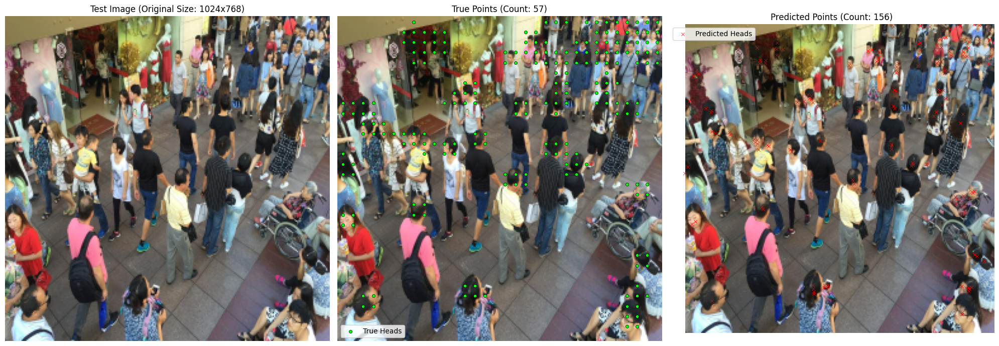

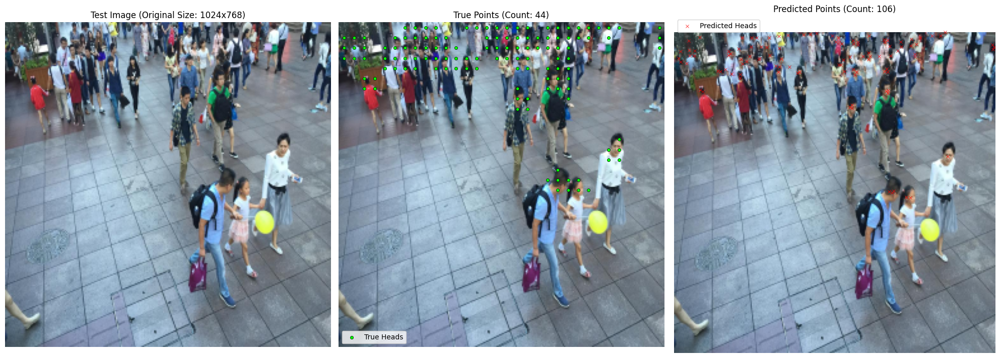

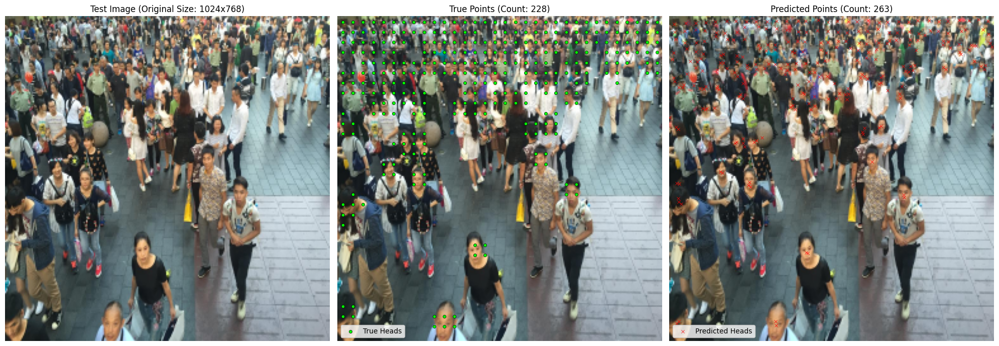

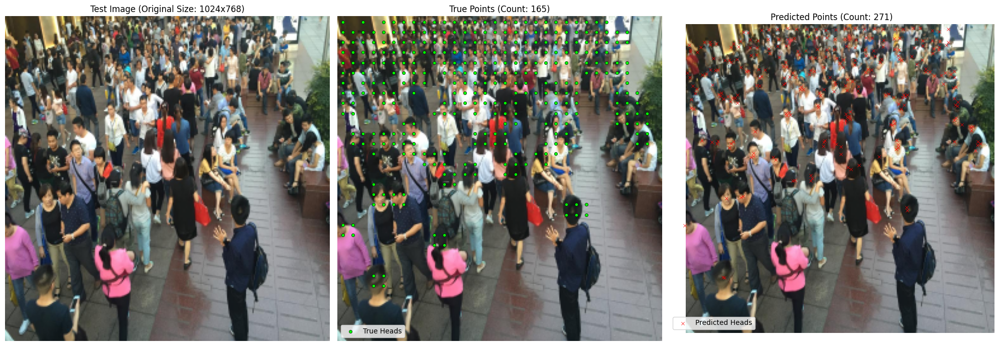

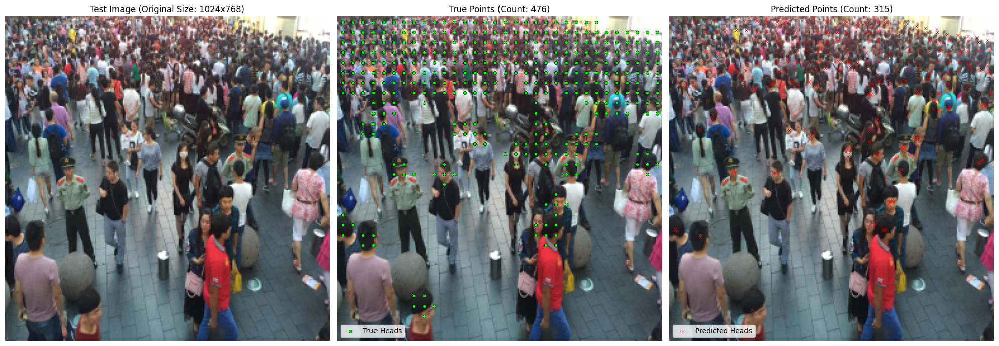


--- PyTorch Test Set Evaluation Metrics ---
Mean Absolute Error (MAE) on Test Set: 86.80
Root Mean Squared Error (RMSE) on Test Set: 94.89

✅ Enhanced APGCC-style PyTorch implementation complete.
Further steps: Fine-tune hyperparameters (especially MATCH_DIST_THRESHOLD, learning rate, OFFSET_LOSS_WEIGHT), try other pre-trained backbones (e.g., ResNet50), and explore more advanced NMS strategies or density map regression if appropriate for dataset characteristics.


In [49]:
print("\n--- Performing Inference and Evaluation on PyTorch TEST Images ---")
model_pytorch.eval()

total_true_counts = []
total_pred_counts = []

# Get actual image dimensions for plotting
first_test_img_path = all_test_image_paths[0]
first_test_image = Image.open(first_test_img_path).convert("RGB")
original_test_w, original_test_h = first_test_image.size

with torch.no_grad():
    for i, (images, targets) in enumerate(tqdm(test_loader, desc="Processing PyTorch test images")):
        if i >= 10: # Show first 10 samples for visualization
            break
        
        y_true_conf, y_true_offset = targets
        images = images.to(device)
        
        with autocast(enabled=device.type == 'cuda'):
            y_pred_conf_logits, y_pred_offset = model_pytorch(images)
        
        # Convert logits to probabilities for confidence map
        pred_conf_map = torch.sigmoid(y_pred_conf_logits).squeeze(0).squeeze(0).cpu().numpy()
        pred_offset_map = y_pred_offset.squeeze(0).permute(1, 2, 0).cpu().numpy()

        # Process a single image from the batch for visualization (since test_loader batch_size=1)
        image_display_tensor = images.squeeze(0).cpu()
        # De-normalize image for display if Normalize was applied with ImageNet stats
        mean = np.array([0.485, 0.456, 0.406]).reshape(3, 1, 1)
        std = np.array([0.229, 0.224, 0.225]).reshape(3, 1, 1)
        image_display_np = (image_display_tensor.numpy() * std + mean).transpose(1, 2, 0)
        image_display_np = np.clip(image_display_np, 0, 1) # Clip to ensure valid RGB range

        # True points (for evaluation and display)
        true_conf_map_display = y_true_conf.squeeze(0).squeeze(0).cpu().numpy()
        true_points_from_map_y, true_points_from_map_x = np.where(true_conf_map_display > 0)
        true_points_reconstructed = []
        if true_points_from_map_y.size > 0:
            true_points_reconstructed_x = (true_points_from_map_x * STRIDE) + (STRIDE / 2)
            true_points_reconstructed_y = (true_points_from_map_y * STRIDE) + (STRIDE / 2)
            true_points_reconstructed = np.stack([true_points_reconstructed_x, true_points_reconstructed_y], axis=1)
        
        true_count_actual = len(load_points_from_mat(all_test_gt_paths[i])) # Use original count
        total_true_counts.append(true_count_actual)

        # Extract predicted points and apply NMS
        predicted_points_raw = []
        scores_raw = []
        feature_map_height_pred, feature_map_width_pred = pred_conf_map.shape # Get actual prediction dimensions

        for fy in range(feature_map_height_pred):
            for fx in range(feature_map_width_pred):
                conf = pred_conf_map[fy, fx]
                if conf >= CONFIDENCE_THRESHOLD:
                    # Calculate predicted point in resized image coordinates
                    pred_x_resized_scale = (fx * STRIDE) + (STRIDE / 2) + (pred_offset_map[fy, fx, 0] * STRIDE)
                    pred_y_resized_scale = (fy * STRIDE) + (STRIDE / 2) + (pred_offset_map[fy, fx, 1] * STRIDE)
                    
                    predicted_points_raw.append([pred_x_resized_scale, pred_y_resized_scale])
                    scores_raw.append(conf)
                    final_predicted_count = 0
        filtered_points_np = np.array([])
        if len(predicted_points_raw) > 0:
            predicted_points_tensor = torch.tensor(predicted_points_raw, dtype=torch.float32, device=device)
            scores_tensor = torch.tensor(scores_raw, dtype=torch.float32, device=device)
            nms_box_size = 5 
            boxes_for_nms = torch.zeros((predicted_points_tensor.shape[0], 4), dtype=torch.float32, device=device)
            boxes_for_nms[:, 0] = predicted_points_tensor[:, 0] - nms_box_size / 2.0  # x1
            boxes_for_nms[:, 1] = predicted_points_tensor[:, 1] - nms_box_size / 2.0  # y1
            boxes_for_nms[:, 2] = predicted_points_tensor[:, 0] + nms_box_size / 2.0  # x2
            boxes_for_nms[:, 3] = predicted_points_tensor[:, 1] + nms_box_size / 2.0  # y2

            selected_indices = nms(boxes_for_nms, scores_tensor, NMS_IOU_THRESHOLD)
            
            # Get the actual points (not the boxes) that survived NMS
            final_predicted_points_tensor = predicted_points_tensor[selected_indices]
            final_predicted_count = len(final_predicted_points_tensor)
            filtered_points_np = final_predicted_points_tensor.cpu().numpy()
        
        total_pred_counts.append(final_predicted_count)

        # Visualization
        plt.figure(figsize=(20, 7))

        plt.subplot(1, 3, 1)
        plt.imshow(image_display_np)
        plt.title(f"Test Image (Original Size: {original_test_w}x{original_test_h})")
        plt.axis('off')

        plt.subplot(1, 3, 2)
        plt.imshow(image_display_np)
        if true_points_reconstructed.size > 0:
            plt.scatter(true_points_reconstructed[:, 0], true_points_reconstructed[:, 1], 
                        s=20, c='lime', marker='o', edgecolors='black', linewidth=0.5, label='True Heads')
        plt.title(f"True Points (Count: {true_count_actual})")
        plt.axis('off')
        plt.legend()

        plt.subplot(1, 3, 3)
        plt.imshow(image_display_np)
        if filtered_points_np.size > 0:
            plt.scatter(filtered_points_np[:, 0], filtered_points_np[:, 1], 
                        s=20, c='red', marker='x', edgecolors='black', linewidth=0.5, label='Predicted Heads')
        plt.title(f"Predicted Points (Count: {final_predicted_count})")
        plt.axis('off')
        plt.legend()
        
        plt.tight_layout()
        plt.show()

# Calculate MAE and RMSE for the entire test set
if total_true_counts:
    true_test_counts_np = np.array(total_true_counts)
    predicted_test_counts_np = np.array(total_pred_counts)

    mae = np.mean(np.abs(true_test_counts_np - predicted_test_counts_np))
    rmse = np.sqrt(np.mean(np.square(true_test_counts_np - predicted_test_counts_np)))

    print(f"\n--- PyTorch Test Set Evaluation Metrics ---") 
    print(f"Mean Absolute Error (MAE) on Test Set: {mae:.2f}")
    print(f"Root Mean Squared Error (RMSE) on Test Set: {rmse:.2f}")
else:
    print("\nNo test samples processed for PyTorch evaluation. Please check test data loading.")

print("\n Enhanced APGCC-style PyTorch implementation complete.")

DBSCAN for removing multiple detections

In [50]:
MODEL_PATH = 'best_apgcc_model.pth' # Your trained model path (saved in current directory)
VIDEO_SOURCE_PATH = '/kaggle/input/test-video-crowd-counting' # Placeholder for separate video inference 

In [51]:
DATASET_BASE_PATH = '/kaggle/input/crowd-counting' # Root as defined in your training script
CROWD_WALA_DATASET_ROOT = os.path.join(DATASET_BASE_PATH, 'crowd_wala_dataset') # The actual root for train/test data

TEST_DATA_PATH = os.path.join(CROWD_WALA_DATASET_ROOT, 'test_data')
TEST_IMAGES_DIR = os.path.join(TEST_DATA_PATH, 'images')
TEST_GT_DIR = os.path.join(TEST_DATA_PATH, 'ground_truth')

# Verify paths
if not os.path.exists(TEST_IMAGES_DIR):
    print(f"Error: Test images directory not found: {TEST_IMAGES_DIR}. Please check the path.")
    exit()
if not os.path.exists(TEST_GT_DIR):
    print(f"Error: Test ground truth directory not found: {TEST_GT_DIR}. Please check the path.")
    exit()
print(f"Test dataset paths verified:")
print(f"  Images: {TEST_IMAGES_DIR}")
print(f"  Ground Truth: {TEST_GT_DIR}")

Test dataset paths verified:
  Images: /kaggle/input/crowd-counting/crowd_wala_dataset/test_data/images
  Ground Truth: /kaggle/input/crowd-counting/crowd_wala_dataset/test_data/ground_truth


In [52]:
class CrowdCountDataset(torch.utils.data.Dataset):
    def __init__(self, img_paths, gt_paths, transform=None, stride=8):
        self.img_paths = img_paths
        self.gt_paths = gt_paths
        self.transform = transform
        self.stride = stride

    def __len__(self):
        return len(self.img_paths)

    def __getitem__(self, idx):
        img_path = self.img_paths[idx]
        gt_path = self.gt_paths[idx]

        img = cv2.imread(img_path)
        if img is None:
            raise FileNotFoundError(f"Image not found at {img_path}")
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        points = load_points_from_mat(gt_path)

        if self.transform:
            transformed = self.transform(image=img)
            img = transformed['image']
        else:
            img = cv2.resize(img, (IMG_WIDTH, IMG_HEIGHT), interpolation=cv2.INTER_AREA)
            img = A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225))(image=img)['image']
            img = ToTensorV2()(image=img)['image']


        # IMPORTANT: These true_conf_map and true_offset_map are DUMMY ZEROS 
        # as they are not used for model inference in this script.
        # The 'true_count_actual' for MAE calculation comes from load_points_from_mat.
        true_conf_map = torch.zeros((1, IMG_HEIGHT // self.stride, IMG_WIDTH // self.stride), dtype=torch.float32)
        true_offset_map = torch.zeros((2, IMG_HEIGHT // self.stride, IMG_WIDTH // self.stride), dtype=torch.float32)
        
        return img, (true_conf_map, true_offset_map)


In [53]:
eval_transforms = A.Compose([
    A.Resize(IMG_HEIGHT, IMG_WIDTH, interpolation=cv2.INTER_AREA),
    A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
    ToTensorV2(),
], keypoint_params=A.KeypointParams(format='xy', remove_invisible=False))


test_dataset = CrowdCountDataset(
    img_paths=all_test_image_paths,
    gt_paths=all_test_gt_paths,
    transform=eval_transforms,
    stride=STRIDE
)

test_loader = torch.utils.data.DataLoader(
    test_dataset,
    batch_size=1, # Important: Your current loop assumes batch_size=1 for visualization
    shuffle=False,
    num_workers=os.cpu_count() // 2 or 2, # Adjust based on your system, 0 for debugging
    pin_memory=True if device.type == 'cuda' else False
)
print(f"Number of test batches: {len(test_loader)}")

Number of test batches: 316


In [54]:

model_pytorch = APGCCPointNet().to(device)
if os.path.exists(MODEL_PATH):
    model_pytorch.load_state_dict(torch.load(MODEL_PATH, map_location=device))
    model_pytorch.eval()
    print(f"Loaded trained model from {MODEL_PATH}")
else:
    print(f"Error: Model file '{MODEL_PATH}' not found. Please ensure it's in the correct directory.")
    print("Cannot proceed with evaluation without a model.")
    exit()

# --- Evaluation Loop ---
print("\n--- Performing Inference and Evaluation on PyTorch TEST Images (with DBSCAN post-processing) ---")
model_pytorch.eval()

total_true_counts_nms = []
total_pred_counts_nms = []
total_true_counts_dbscan = []
total_pred_counts_dbscan = []

# --- Debugging Flags (kept for future use if needed) ---
DEBUG_PRINTS = False # Set to True for detailed prints on the first sample

Loaded trained model from best_apgcc_model.pth

--- Performing Inference and Evaluation on PyTorch TEST Images (with DBSCAN post-processing) ---


In [55]:
DBSCAN_EPS = 5 # DBSCAN parameter: maximum distance between two samples for one to be considered as in the neighborhood of the other.
DBSCAN_MIN_SAMPLES = 1 # DBSCAN parameter: number of samples (or total weight) in a neighborhood for a point to be considered as a core point.

Processing PyTorch test images:   0%|          | 0/316 [00:00<?, ?it/s]

/tmp/ipykernel_35/1397810910.py:13: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast(enabled=device.type == 'cuda'):
/tmp/ipykernel_35/1397810910.py:152: UserWarning: You passed a edgecolor/edgecolors ('black') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  plt.scatter(filtered_points_np_nms[:, 0], filtered_points_np_nms[:, 1],


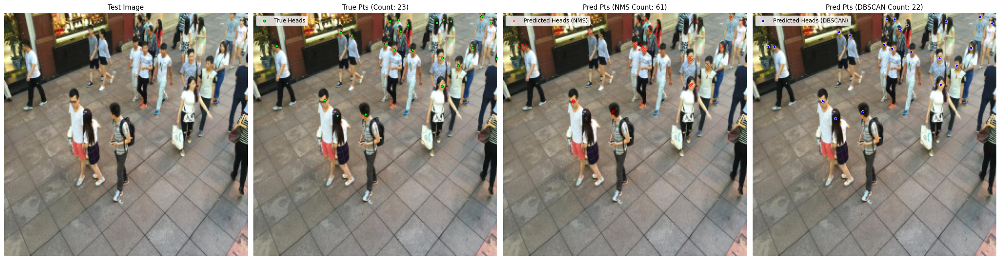

/tmp/ipykernel_35/1397810910.py:13: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast(enabled=device.type == 'cuda'):
/tmp/ipykernel_35/1397810910.py:152: UserWarning: You passed a edgecolor/edgecolors ('black') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  plt.scatter(filtered_points_np_nms[:, 0], filtered_points_np_nms[:, 1],


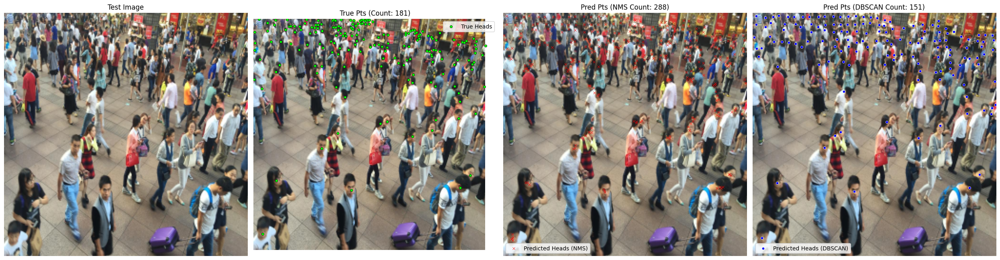

/tmp/ipykernel_35/1397810910.py:13: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast(enabled=device.type == 'cuda'):
/tmp/ipykernel_35/1397810910.py:152: UserWarning: You passed a edgecolor/edgecolors ('black') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  plt.scatter(filtered_points_np_nms[:, 0], filtered_points_np_nms[:, 1],


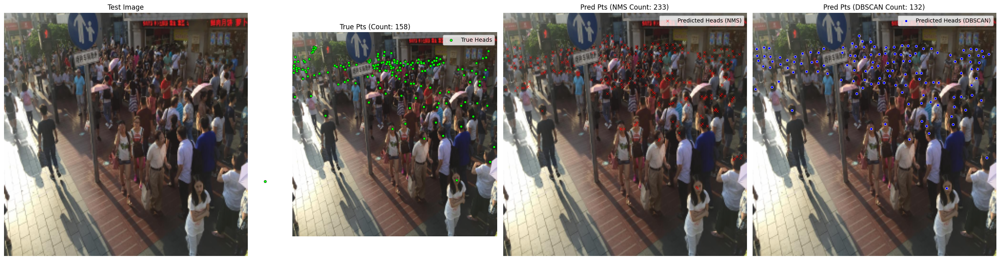

/tmp/ipykernel_35/1397810910.py:13: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast(enabled=device.type == 'cuda'):
/tmp/ipykernel_35/1397810910.py:152: UserWarning: You passed a edgecolor/edgecolors ('black') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  plt.scatter(filtered_points_np_nms[:, 0], filtered_points_np_nms[:, 1],


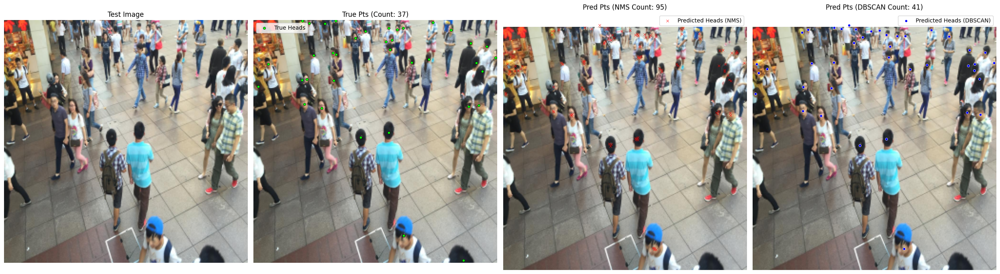

/tmp/ipykernel_35/1397810910.py:13: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast(enabled=device.type == 'cuda'):
/tmp/ipykernel_35/1397810910.py:152: UserWarning: You passed a edgecolor/edgecolors ('black') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  plt.scatter(filtered_points_np_nms[:, 0], filtered_points_np_nms[:, 1],


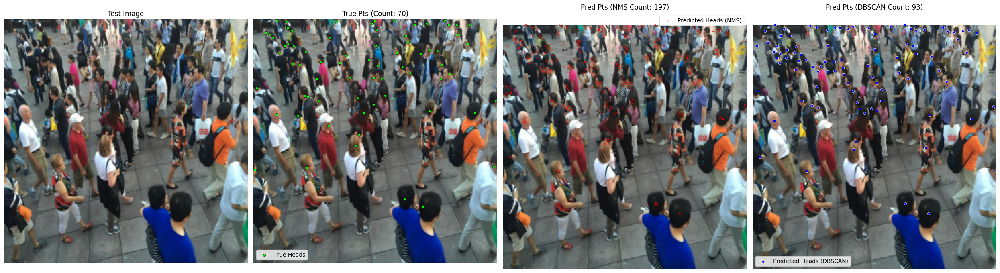

/tmp/ipykernel_35/1397810910.py:13: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast(enabled=device.type == 'cuda'):
/tmp/ipykernel_35/1397810910.py:152: UserWarning: You passed a edgecolor/edgecolors ('black') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  plt.scatter(filtered_points_np_nms[:, 0], filtered_points_np_nms[:, 1],


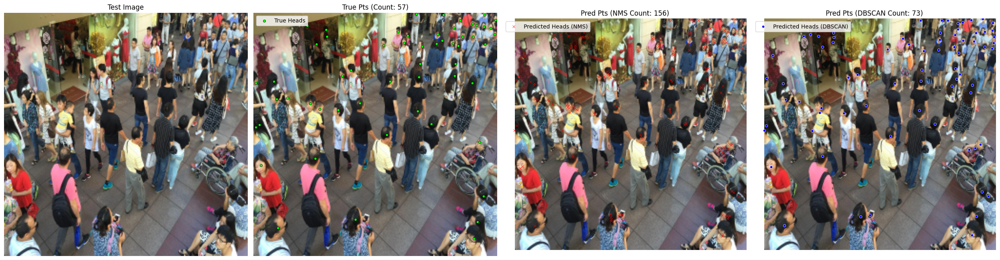

/tmp/ipykernel_35/1397810910.py:13: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast(enabled=device.type == 'cuda'):
/tmp/ipykernel_35/1397810910.py:152: UserWarning: You passed a edgecolor/edgecolors ('black') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  plt.scatter(filtered_points_np_nms[:, 0], filtered_points_np_nms[:, 1],


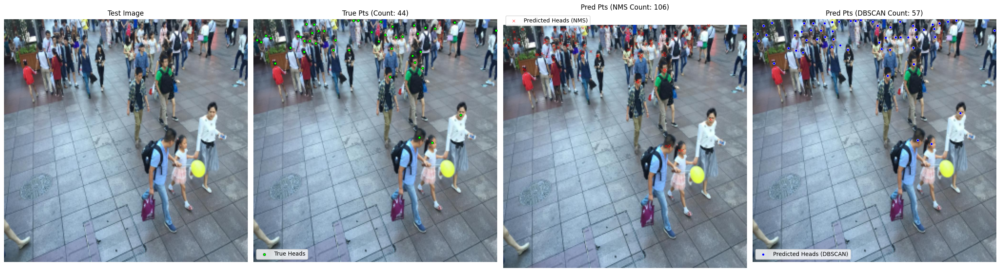

/tmp/ipykernel_35/1397810910.py:13: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast(enabled=device.type == 'cuda'):
/tmp/ipykernel_35/1397810910.py:152: UserWarning: You passed a edgecolor/edgecolors ('black') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  plt.scatter(filtered_points_np_nms[:, 0], filtered_points_np_nms[:, 1],


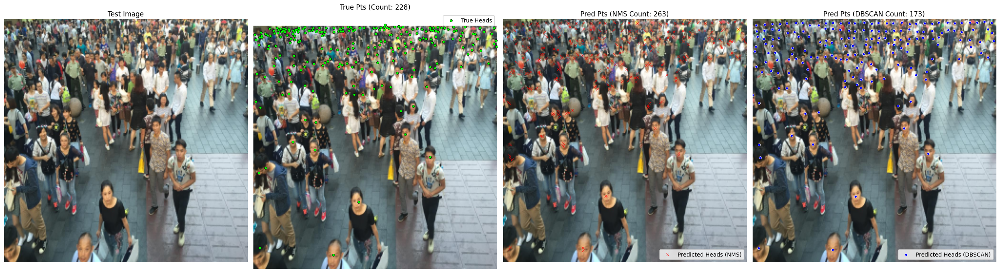

/tmp/ipykernel_35/1397810910.py:13: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast(enabled=device.type == 'cuda'):
/tmp/ipykernel_35/1397810910.py:152: UserWarning: You passed a edgecolor/edgecolors ('black') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  plt.scatter(filtered_points_np_nms[:, 0], filtered_points_np_nms[:, 1],


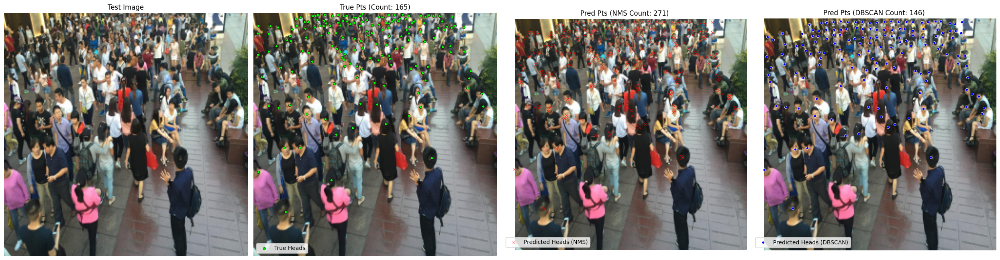

/tmp/ipykernel_35/1397810910.py:13: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast(enabled=device.type == 'cuda'):
/tmp/ipykernel_35/1397810910.py:152: UserWarning: You passed a edgecolor/edgecolors ('black') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  plt.scatter(filtered_points_np_nms[:, 0], filtered_points_np_nms[:, 1],


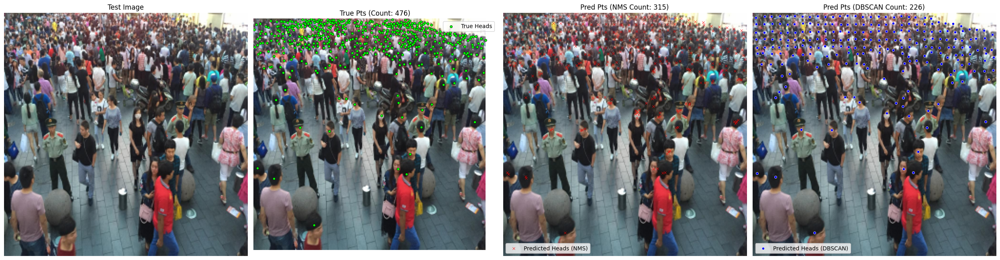

/tmp/ipykernel_35/1397810910.py:13: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast(enabled=device.type == 'cuda'):
/tmp/ipykernel_35/1397810910.py:13: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast(enabled=device.type == 'cuda'):
/tmp/ipykernel_35/1397810910.py:13: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast(enabled=device.type == 'cuda'):
/tmp/ipykernel_35/1397810910.py:13: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast(enabled=device.type == 'cuda'):
/tmp/ipykernel_35/1397810910.py:13: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autoca

In [56]:
with torch.no_grad():
    for i, (images, targets_dummy) in enumerate(tqdm(test_loader, desc="Processing PyTorch test images")):
        # Load the true count directly from the original GT file for accurate evaluation
        current_original_gt_path = all_test_gt_paths[i]
        true_points_original_res = load_points_from_mat(current_original_gt_path)
        true_count_actual = len(true_points_original_res)
        
        total_true_counts_nms.append(true_count_actual)
        total_true_counts_dbscan.append(true_count_actual) # True count is the same for both methods

        images = images.to(device)
        
        with autocast(enabled=device.type == 'cuda'):
            y_pred_conf_logits, y_pred_offset = model_pytorch(images)
        
        pred_conf_map = torch.sigmoid(y_pred_conf_logits).squeeze(0).squeeze(0).cpu().numpy()
        pred_offset_map = y_pred_offset.squeeze(0).permute(1, 2, 0).cpu().numpy()
        if DEBUG_PRINTS and i == 0:
            print(f"\n--- Debugging Sample {i+1} ---")
            print(f"Input image shape: {images.shape}")
            print(f"Predicted confidence map logits shape: {y_pred_conf_logits.shape}")
            print(f"Predicted offset map shape: {y_pred_offset.shape}")
            print(f"Confidence map after sigmoid and squeeze: {pred_conf_map.shape}")
            print(f"Offset map after permute: {pred_offset_map.shape}")
            print(f"True count for this image: {true_count_actual}")
            print(f"Example original GT path: {current_original_gt_path}")


        ### --- Predicted Points (Pre-NMS/Pre-DBSCAN extraction) ---
        predicted_points_raw = []
        scores_raw = []
        feature_map_height_pred, feature_map_width_pred = pred_conf_map.shape

        for fy in range(feature_map_height_pred):
            for fx in range(feature_map_width_pred):
                conf = pred_conf_map[fy, fx]
                if conf >= CONFIDENCE_THRESHOLD:
                    pred_x_resized_scale = (fx * STRIDE) + (STRIDE / 2) + (pred_offset_map[fy, fx, 0] * STRIDE)
                    pred_y_resized_scale = (fy * STRIDE) + (STRIDE / 2) + (pred_offset_map[fy, fx, 1] * STRIDE)
                    predicted_points_raw.append([pred_x_resized_scale, pred_y_resized_scale])
                    scores_raw.append(conf)
        
        predicted_points_raw_np = np.array(predicted_points_raw, dtype=np.float32)
        scores_raw_np = np.array(scores_raw, dtype=np.float32)

        if DEBUG_PRINTS and i == 0:
            print(f"Raw predicted points (before NMS/DBSCAN) count: {len(predicted_points_raw)}")
            if len(predicted_points_raw) > 0:
                print(f"First 5 raw predicted points: {predicted_points_raw[:5]}")
                print(f"First 5 raw scores: {scores_raw[:5]}")

#NMS FOR COMAPRISON OF POST PROCESSING TECHNIQUES
        final_predicted_count_nms = 0
        filtered_points_np_nms = np.array([])
        if predicted_points_raw_np.size > 0:
            predicted_points_tensor_nms = torch.tensor(predicted_points_raw_np, dtype=torch.float32, device=device)
            scores_tensor_nms = torch.tensor(scores_raw_np, dtype=torch.float32, device=device)
            nms_box_size = 5 
            boxes_for_nms = torch.zeros((predicted_points_tensor_nms.shape[0], 4), dtype=torch.float32, device=device)
            boxes_for_nms[:, 0] = predicted_points_tensor_nms[:, 0] - nms_box_size / 2.0
            boxes_for_nms[:, 1] = predicted_points_tensor_nms[:, 1] - nms_box_size / 2.0
            boxes_for_nms[:, 2] = predicted_points_tensor_nms[:, 0] + nms_box_size / 2.0
            boxes_for_nms[:, 3] = predicted_points_tensor_nms[:, 1] + nms_box_size / 2.0

            selected_indices_nms = nms(boxes_for_nms, scores_tensor_nms, NMS_IOU_THRESHOLD)
            
            final_predicted_points_tensor_nms = predicted_points_tensor_nms[selected_indices_nms]
            final_predicted_count_nms = len(final_predicted_points_tensor_nms)
            filtered_points_np_nms = final_predicted_points_tensor_nms.cpu().numpy()
        
        total_pred_counts_nms.append(final_predicted_count_nms)

        if DEBUG_PRINTS and i == 0:
            print(f"NMS predicted count: {final_predicted_count_nms}")
        final_predicted_count_dbscan = 0
        clustered_points_dbscan = np.array([])

        if predicted_points_raw_np.size > 0:
            clustering = DBSCAN(eps=DBSCAN_EPS, min_samples=DBSCAN_MIN_SAMPLES).fit(predicted_points_raw_np)
            labels = clustering.labels_
            
            n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0) # Exclude noise points (-1 label)
            
            cluster_centers = []
            for k in range(n_clusters_):
                class_members = predicted_points_raw_np[labels == k]
                if len(class_members) > 0:
                    cluster_center = np.mean(class_members, axis=0) # Take mean as cluster center
                    cluster_centers.append(cluster_center)
            
            clustered_points_dbscan = np.array(cluster_centers)
            final_predicted_count_dbscan = len(clustered_points_dbscan)
        
        total_pred_counts_dbscan.append(final_predicted_count_dbscan)

        if DEBUG_PRINTS and i == 0:
            print(f"DBSCAN predicted count: {final_predicted_count_dbscan}")
        if i < 10: 
            image_display_tensor = images.squeeze(0).cpu()
            mean = np.array([0.485, 0.456, 0.406]).reshape(3, 1, 1)
            std = np.array([0.229, 0.224, 0.225]).reshape(3, 1, 1)
            image_display_np = (image_display_tensor.numpy() * std + mean).transpose(1, 2, 0)
            image_display_np = np.clip(image_display_np, 0, 1)

            plt.figure(figsize=(25, 7))
            # Subplot 1: Test Image
            plt.subplot(1, 4, 1)
            plt.imshow(image_display_np)
            plt.title(f"Test Image")
            plt.axis('off')

            # Subplot 2: True Points
            plt.subplot(1, 4, 2)
            plt.imshow(image_display_np)
            # Scale true points to match the resized image display
            if true_points_original_res.size > 0:
                original_img = cv2.imread(all_test_image_paths[i])
                original_h_img, original_w_img, _ = original_img.shape
                
                scale_x_true = IMG_WIDTH / original_w_img
                scale_y_true = IMG_HEIGHT / original_h_img
                
                true_points_scaled_for_plot = true_points_original_res.copy()
                true_points_scaled_for_plot[:, 0] = true_points_scaled_for_plot[:, 0] * scale_x_true
                true_points_scaled_for_plot[:, 1] = true_points_scaled_for_plot[:, 1] * scale_y_true

                plt.scatter(true_points_scaled_for_plot[:, 0], true_points_scaled_for_plot[:, 1],
                            s=20, c='lime', marker='o', edgecolors='black', linewidth=0.5, label='True Heads')
            plt.title(f"True Pts (Count: {true_count_actual})")
            plt.axis('off')
            plt.legend()

            # Subplot 3: Predicted Points (NMS)
            plt.subplot(1, 4, 3)
            plt.imshow(image_display_np)
            if filtered_points_np_nms.size > 0:
                plt.scatter(filtered_points_np_nms[:, 0], filtered_points_np_nms[:, 1],
                            s=20, c='red', marker='x', edgecolors='black', linewidth=0.5, label='Predicted Heads (NMS)')
            plt.title(f"Pred Pts (NMS Count: {final_predicted_count_nms})")
            plt.axis('off')
            plt.legend()

            # Subplot 4: Predicted Points (DBSCAN)
            plt.subplot(1, 4, 4)
            plt.imshow(image_display_np)
            if clustered_points_dbscan.size > 0:
                plt.scatter(clustered_points_dbscan[:, 0], clustered_points_dbscan[:, 1],
                            s=20, c='blue', marker='o', edgecolors='white', linewidth=0.5, label='Predicted Heads (DBSCAN)')
            plt.title(f"Pred Pts (DBSCAN Count: {final_predicted_count_dbscan})")
            plt.axis('off')
            plt.legend()
            
            plt.tight_layout()
            plt.show()
           

In [57]:
if total_true_counts_nms:
    true_test_counts_np = np.array(total_true_counts_nms)
    
    predicted_test_counts_nms_np = np.array(total_pred_counts_nms)
    mae_nms = np.mean(np.abs(true_test_counts_np - predicted_test_counts_nms_np))
    rmse_nms = np.sqrt(np.mean(np.square(true_test_counts_np - predicted_test_counts_nms_np)))

    predicted_test_counts_dbscan_np = np.array(total_pred_counts_dbscan)
    mae_dbscan = np.mean(np.abs(true_test_counts_np - predicted_test_counts_dbscan_np))
    rmse_dbscan = np.sqrt(np.mean(np.square(true_test_counts_np - predicted_test_counts_dbscan_np)))

    print(f"\n--- PyTorch Test Set Evaluation Metrics ---")
    print(f"Original Method (NMS):")
    print(f"  Mean Absolute Error (MAE): {mae_nms:.2f}")
    print(f"  Root Mean Squared Error (RMSE): {rmse_nms:.2f}")
    print(f"DBSCAN Post-Processing (EPS={DBSCAN_EPS}, MIN_SAMPLES={DBSCAN_MIN_SAMPLES}):")
    print(f"  Mean Absolute Error (MAE): {mae_dbscan:.2f}")
    print(f"  Root Mean Squared Error (RMSE): {rmse_dbscan:.2f}")
else:
    print("\nNo test samples processed for PyTorch evaluation. Please check test data loading and paths.")

print("Enhanced APGCC-style PyTorch evaluation with DBSCAN post-processing complete.")


--- PyTorch Test Set Evaluation Metrics ---
Original Method (NMS):
  Mean Absolute Error (MAE): 76.22
  Root Mean Squared Error (RMSE): 85.37
DBSCAN Post-Processing (EPS=5, MIN_SAMPLES=1):
  Mean Absolute Error (MAE): 32.64
  Root Mean Squared Error (RMSE): 62.54

✅ Enhanced APGCC-style PyTorch evaluation with DBSCAN post-processing complete.
